# Data Handling

In [14]:
import pandas as pd

df = pd.read_csv("data/asl_dataset.csv", index_col=0)

# Data Analysis

In [15]:
import matplotlib.pyplot as plt
import numpy as np

In [16]:
classes = df["class"]
set(classes)

{'A',
 'B',
 'C',
 'D',
 'E',
 'F',
 'G',
 'H',
 'I',
 'J',
 'K',
 'L',
 'M',
 'N',
 'O',
 'P',
 'Q',
 'R',
 'S',
 'T',
 'U',
 'V',
 'W',
 'X',
 'Y',
 'Z'}

## Number of examples

In [17]:
counts = np.unique(classes, return_counts=True)
counts

(array(['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M',
        'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z'],
       dtype=object),
 array([929, 903, 946, 857, 789, 879, 976, 961, 915, 919, 906, 898, 837,
        934, 911, 875, 905, 907, 896, 945, 901, 848, 897, 846, 804, 812]))

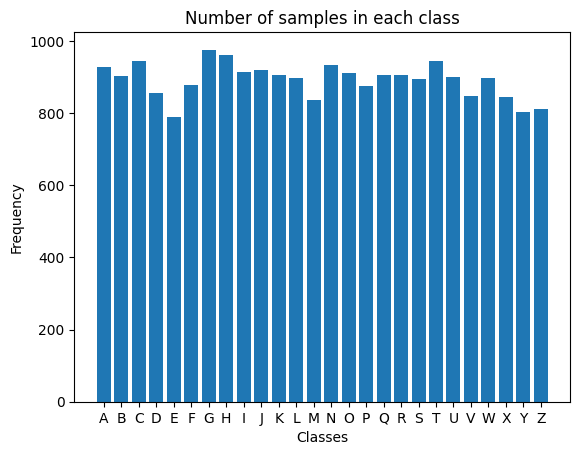

In [18]:
# Plot the histogram using matplotlib
plt.bar(counts[0], counts[1], label=counts[0])  # You can adjust the number of bins as needed
plt.xlabel("Classes")
plt.ylabel("Frequency")
plt.title("Number of samples in each class")
plt.show()

## Data represented visually

In [19]:
from sklearn.manifold import TSNE
import pandas as pd
import seaborn as sns

In [21]:
# Extract the features you want to use for t-SNE
features = df.drop('class', axis=1)  # Replace 'target_column_name' with your target column name

# Initialize and fit the t-SNE model
tsne = TSNE(n_components=2, random_state=10)
tsne_result = tsne.fit_transform(features)

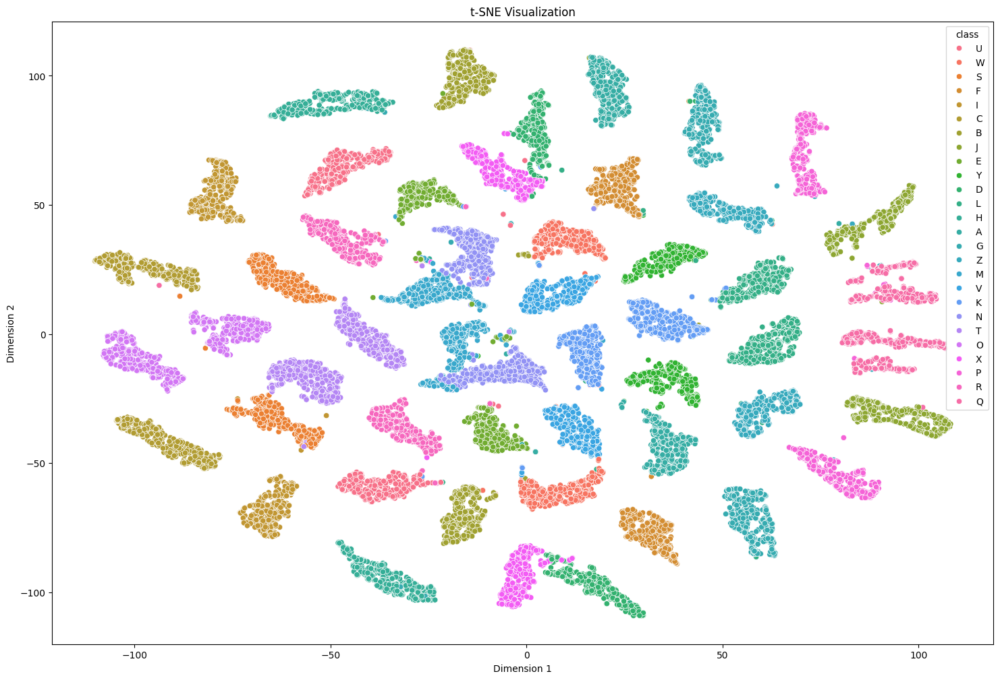

In [23]:
# Create a new Pandas DataFrame for the t-SNE results
tsne_df = pd.DataFrame(data=tsne_result, columns=['Dimension 1', 'Dimension 2'])

# Plot the t-SNE results
plt.figure(figsize=(18, 12))
sns.scatterplot(x=tsne_df['Dimension 1'], y=tsne_df['Dimension 2'], hue=df["class"])
plt.title('t-SNE Visualization')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')
plt.show()

## Type of letter more similar

In [24]:
import pandas as pd
import numpy as np

# Group the data by the 'class' column
grouped = df.groupby('class').mean()

In [25]:
from sklearn.neighbors import NearestNeighbors
related = {}
for c in grouped.index:
    neigh = NearestNeighbors(n_neighbors=2, radius=0.4)
    neigh.fit(grouped[grouped.index != c])
    dist, neighbors = neigh.kneighbors(grouped[grouped.index == c], 1)
    related[c] = list(grouped[grouped.index != c].index)[neighbors[0][0]]

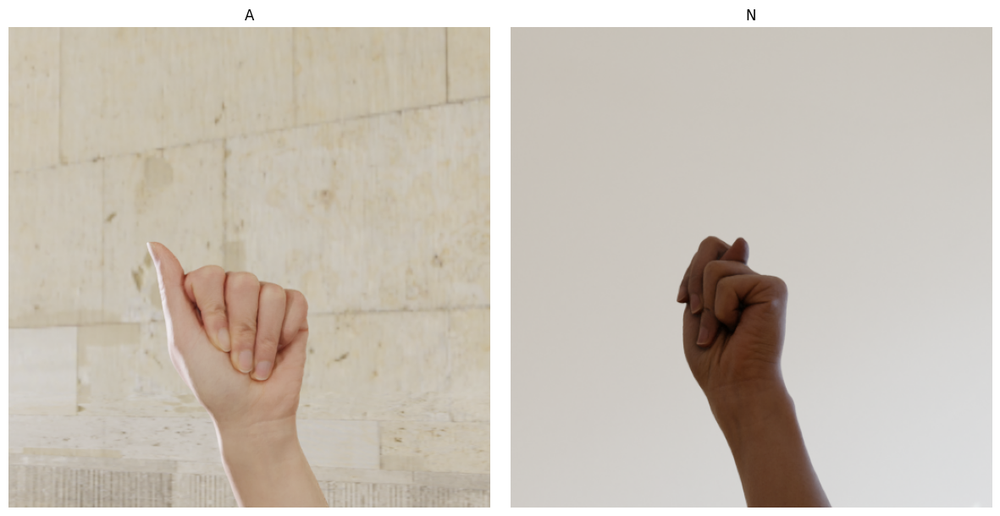

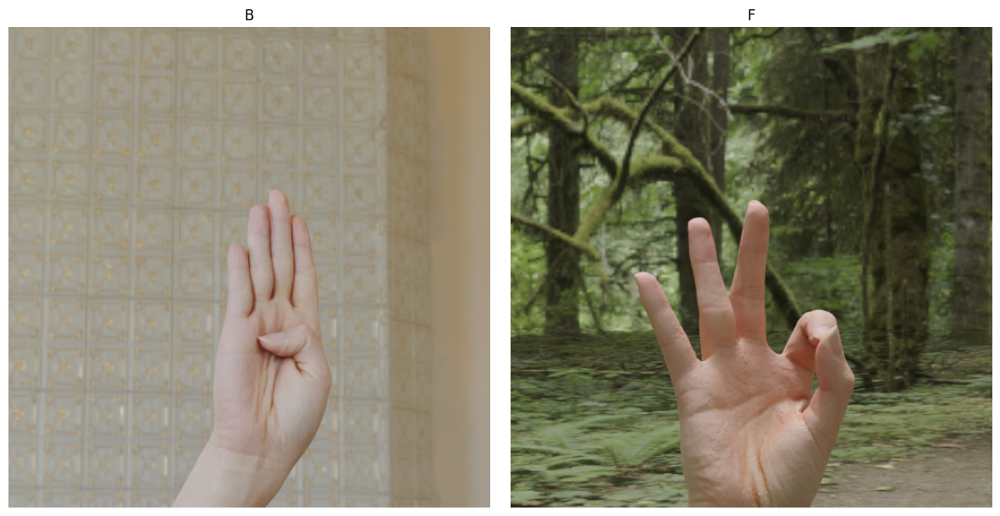

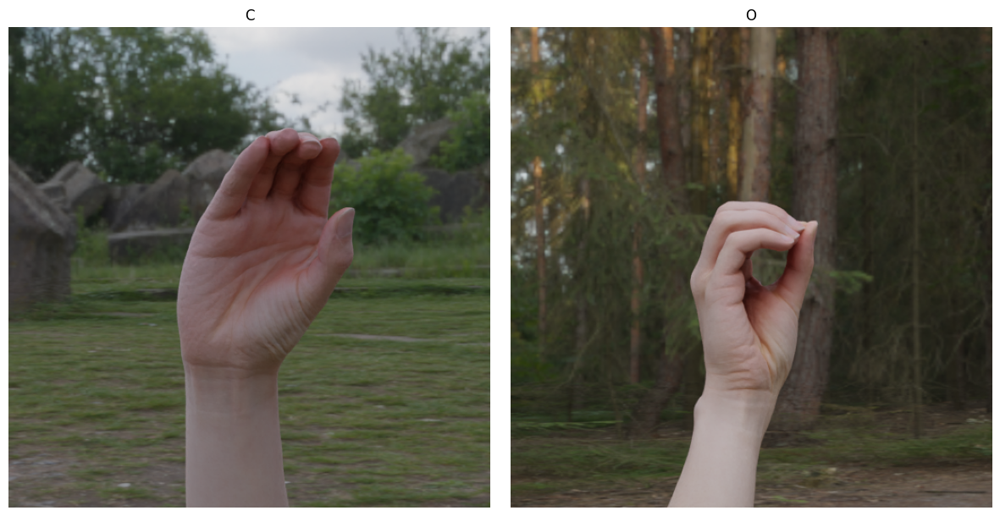

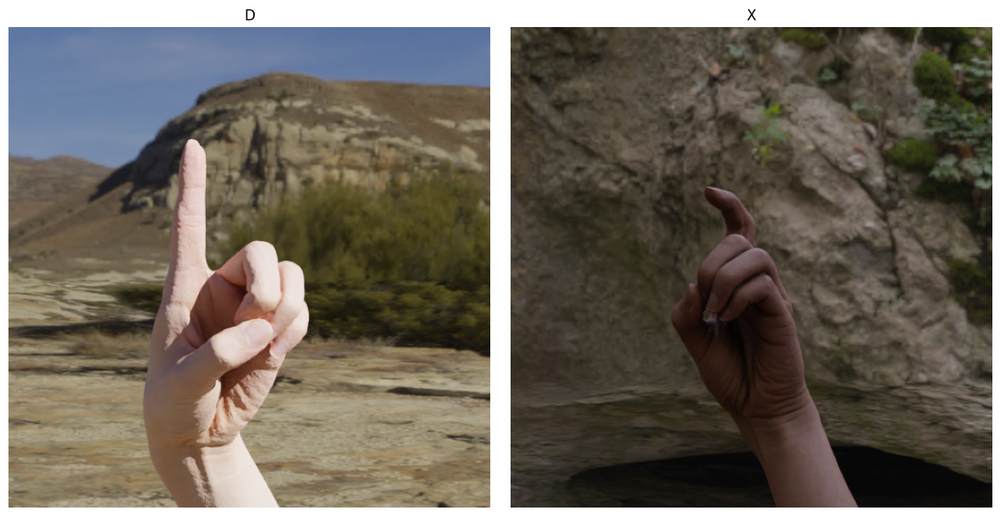

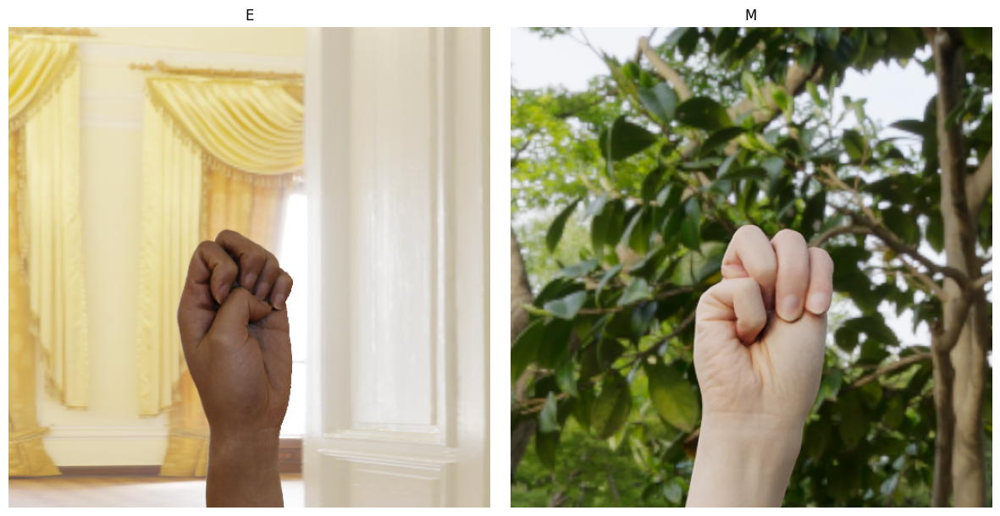

...

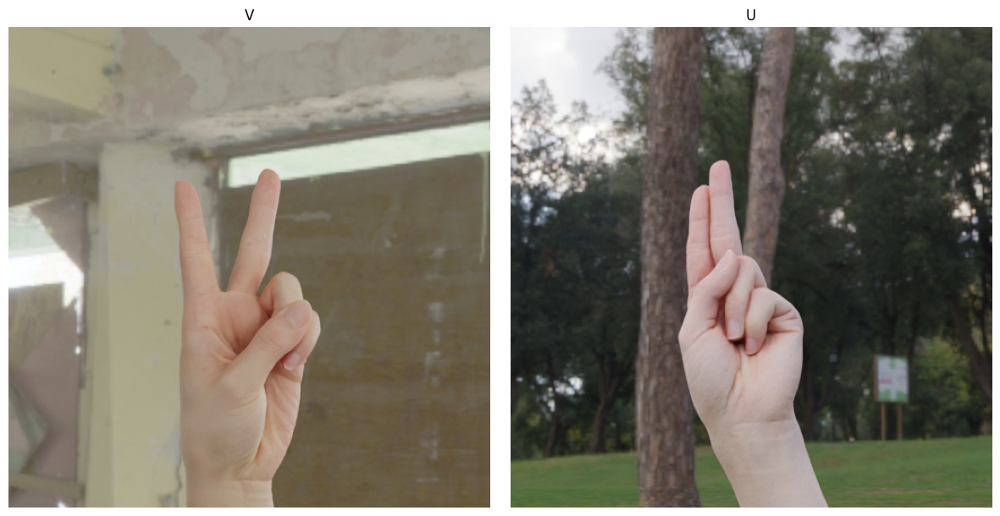

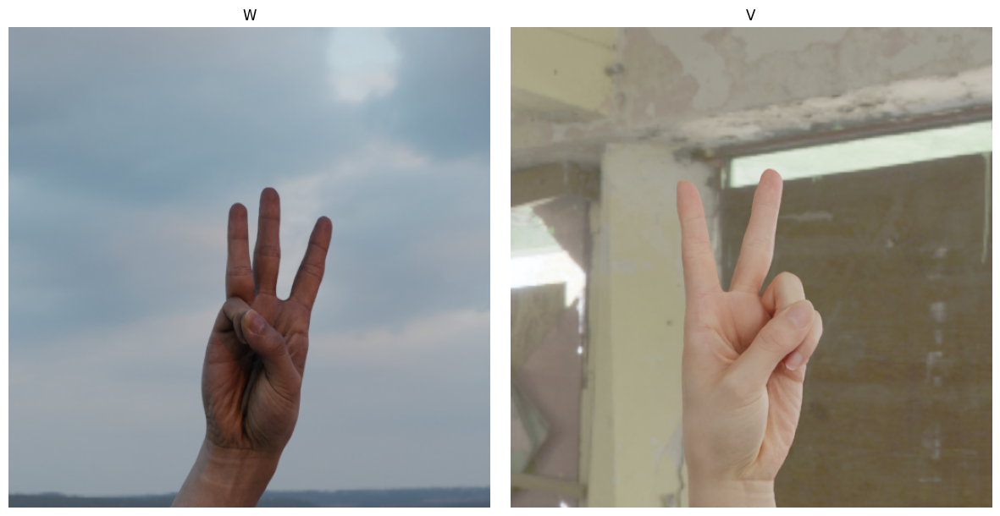

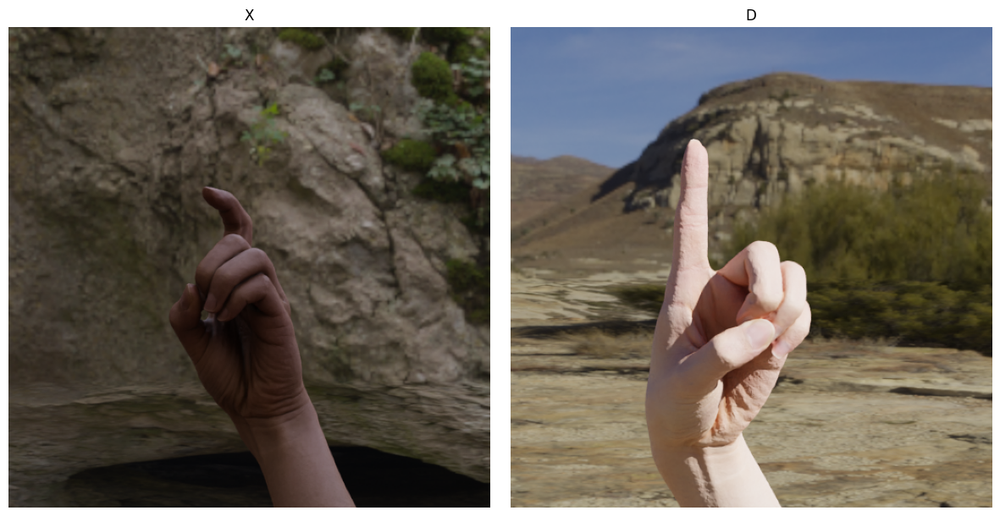

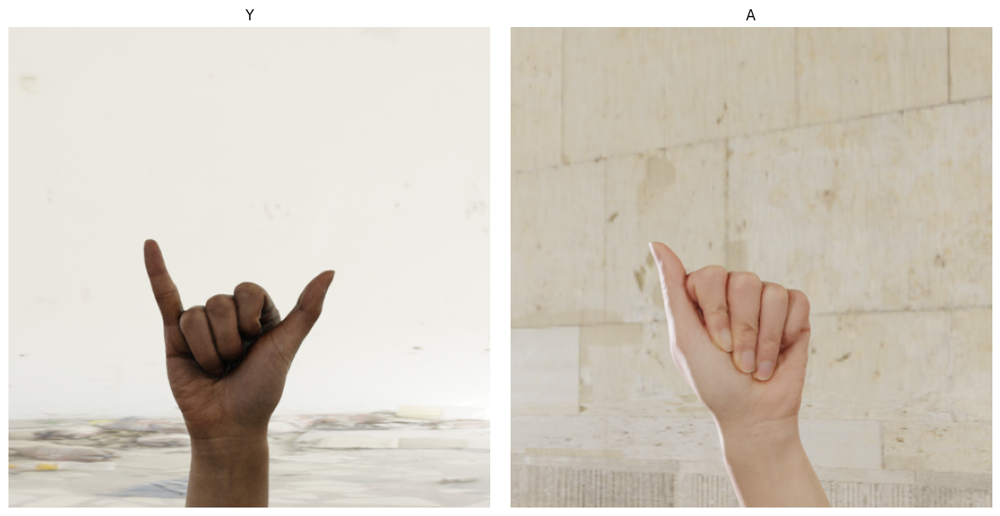

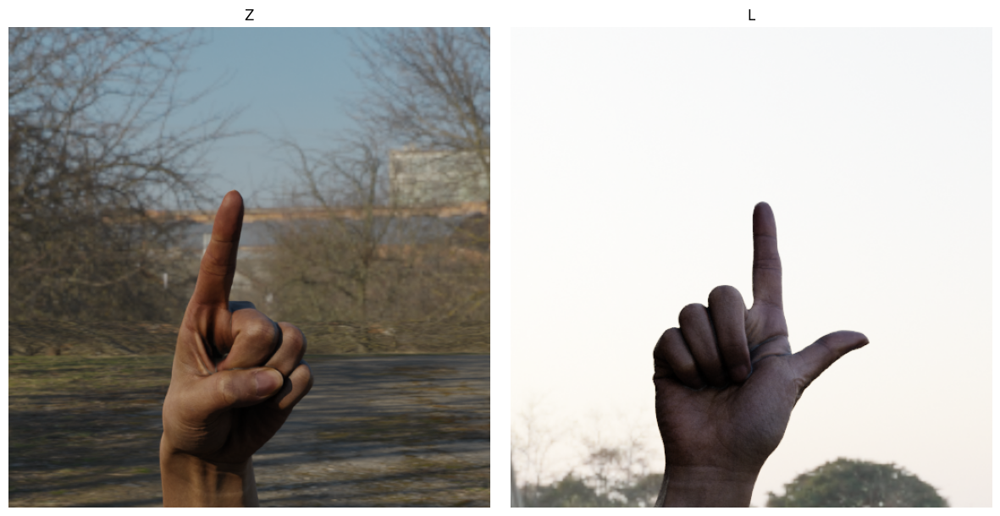

In [26]:
import os
import matplotlib.image as mpimg

for r in related:
    pathA = f"/home/lefcamara/asl_opencv/data/Train_Alphabet/{r}/"
    pathB = f"/home/lefcamara/asl_opencv/data/Train_Alphabet/{related[r]}/"
    imageA = mpimg.imread(pathA + os.listdir(pathA)[0])
    imageB = mpimg.imread(pathB + os.listdir(pathB)[0])
    
    # Create a figure with two subplots side by side
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Display the first image on the left subplot
    axes[0].imshow(imageA)
    axes[0].set_title(f'{r}')
    
    # Display the second image on the right subplot
    axes[1].imshow(imageB)
    axes[1].set_title(f'{related[r]}')
    
    # Remove axis labels and ticks
    for ax in axes:
        ax.axis('off')
        
    # Show the plot
    plt.tight_layout()
    plt.show()